In [1]:
#.libPaths(c("/home/data/t060324/R/x86_64-pc-linux-gnu-library/4.1","/home/data/refdir/Rlib"))
library(scibet)
library(Seurat)
library(scater)
library(scran)
library(dplyr)
library(Matrix)
library(cowplot)
#library(CARD)
library(ggplot2)
rm(list=ls())
library(harmony)
setwd('/home/data/t060324/jobs/aimin/')

The legacy packages maptools, rgdal, and rgeos, underpinning this package
will retire shortly. Please refer to R-spatial evolution reports on
https://r-spatial.org/r/2023/05/15/evolution4.html for details.
This package is now running under evolution status 0 

Attaching SeuratObject

Loading required package: SingleCellExperiment

Loading required package: SummarizedExperiment

Loading required package: MatrixGenerics

Loading required package: matrixStats


Attaching package: ‘MatrixGenerics’


The following objects are masked from ‘package:matrixStats’:

    colAlls, colAnyNAs, colAnys, colAvgsPerRowSet, colCollapse,
    colCounts, colCummaxs, colCummins, colCumprods, colCumsums,
    colDiffs, colIQRDiffs, colIQRs, colLogSumExps, colMadDiffs,
    colMads, colMaxs, colMeans2, colMedians, colMins, colOrderStats,
    colProds, colQuantiles, colRanges, colRanks, colSdDiffs, colSds,
    colSums2, colTabulates, colVarDiffs, colVars, colWeightedMads,
    colWeightedMeans, colWeightedMedians

## P8

In [2]:
ST_obj <- readRDS(file = paste0('./data/GSE211956_RAW/ST_Anchoring/Anchoring_GSM6506117_ST.RDS'))

In [3]:
colnames(ST_obj@meta.data)[8:15] <- c('B_CARD','Plasma_CARD','T_CARD','Myeloid_CARD','NK_CARD','Fibroblasts_CARD','Endothelial_CARD','Tumour_CARD')

In [130]:
colnames(ST_obj@meta.data)

[1] "orig.ident"       "nCount_Spatial"   "nFeature_Spatial" "nCount_SCT"      
 [5] "nFeature_SCT"     "SCT_snn_res.1"    "seurat_clusters"  "B_CARD"          
 [9] "Plasma_CARD"      "T_CARD"           "Myeloid_CARD"     "NK_CARD"         
[13] "Fibroblasts_CARD" "Endothelial_CARD" "Tumour_CARD"      "pred.B"          
[17] "pred.plasma"      "pred.fibo"        "pred.endo"        "pred.T"          
[21] "pred.NK"          "pred.myeloid"     "pred.Epi"         "pred.B_bin"      
[25] "pred.plasma_bin"  "pred.fibo_bin"    "pred.endo_bin"    "pred.T_bin"      
[29] "pred.NK_bin"      "pred.myeloid_bin" "pred.Epi_bin"

In [131]:
colnames(ST_obj@meta.data)[16:23] <- c('B_Seurat','Plasma_Seurat','Fibroblasts_Seurat','Endothelial_Seurat','T_Seurat','NK_Seurat','Myeloid_Seurat','Tumour_Seurat')

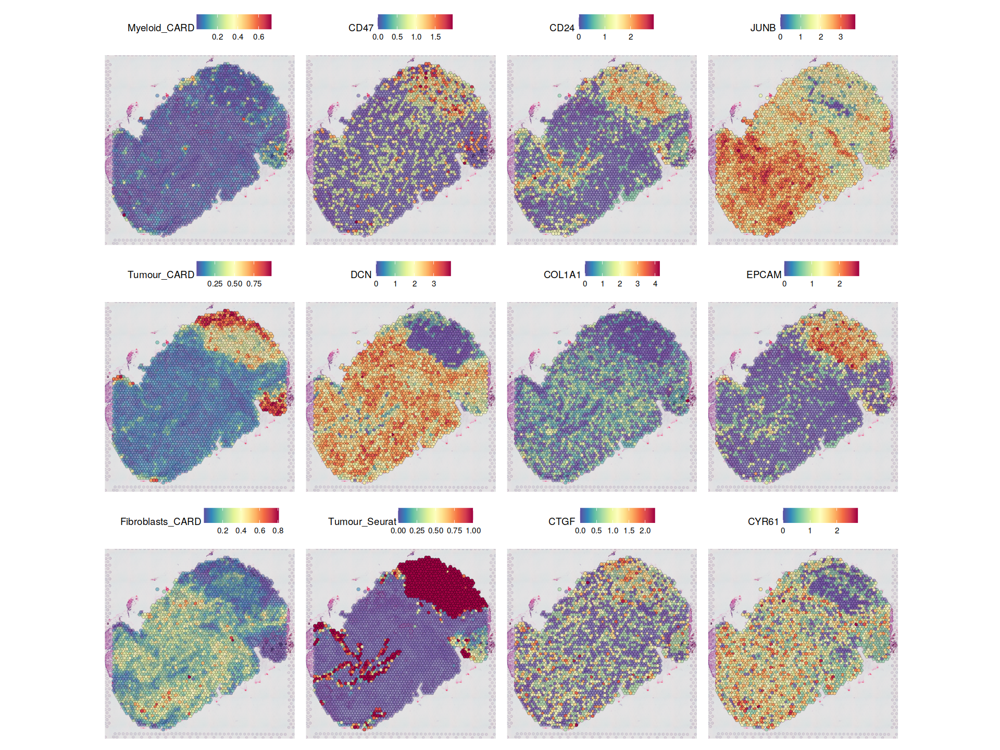

In [132]:
options(repr.plot.height = 12, repr.plot.width = 16)
p3 <- SpatialFeaturePlot(ST_obj, features = c('Myeloid_CARD','CD47','CD24','JUNB','Tumour_CARD','DCN','COL1A1','EPCAM','Fibroblasts_CARD','Tumour_Seurat','CTGF','CYR61'),alpha =  c(0.5, 1),ncol = 4,combine = T)
p3 

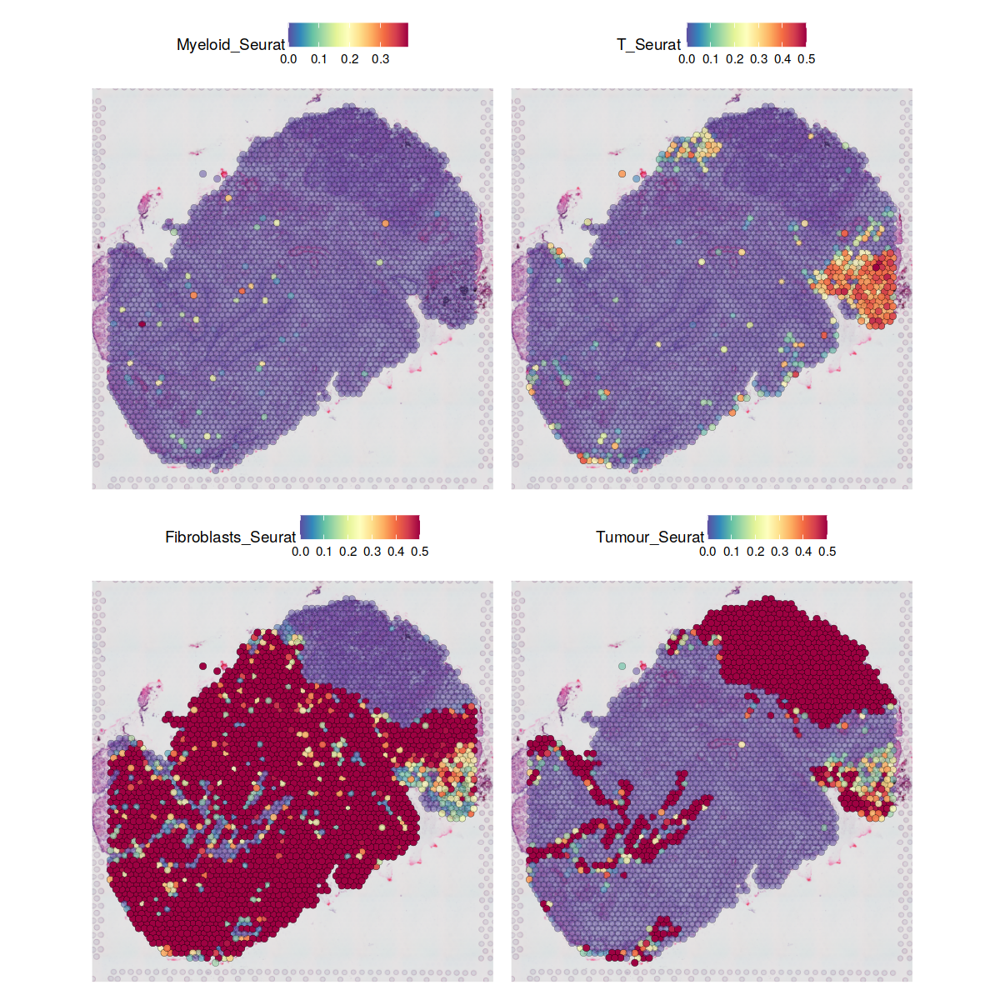

In [7]:
options(repr.plot.height = 10, repr.plot.width = 10)
SpatialFeaturePlot(ST_obj, features = c('Myeloid_Seurat','T_Seurat','Fibroblasts_Seurat','Tumour_Seurat'),alpha =  c(0.5, 1),min.cutoff =0,max.cutoff = 0.5 ,ncol = 2,combine = T)

In [14]:
setwd('/home/data/t060324/jobs/aimin/')
library(CytoTRACE)
ST_obj <- readRDS(file = paste0('./data/GSE211956_RAW/GSM6506117_ST.RDS'))
expr <- as.matrix(ST_obj@assays$Spatial@counts)
results <- CytoTRACE(mat=expr,enableFast=F)
saveRDS(results,file='./output/5.ST_CytoTRACE/CytoTRACE_GSM6506117_results.RDS')
gc()

Welcome to the CytoTRACE R package, a tool for the unbiased prediction of differentiation states in scRNA-seq data. For more information about this method, visit https://cytotrace.stanford.edu.




In [173]:
results <- readRDS(file='./output/5.ST_CytoTRACE/CytoTRACE_GSM6506117_results.RDS')
ST_obj$CytoTRACE <- results$CytoTRACE

In [16]:
head(ST_obj)

,orig.ident,nCount_Spatial,nFeature_Spatial,nCount_SCT,nFeature_SCT,SCT_snn_res.1,seurat_clusters,B_CARD,Plasma_CARD,T_CARD,⋯,Tumour_Seurat,pred.B_bin,pred.plasma_bin,pred.fibo_bin,pred.endo_bin,pred.T_bin,pred.NK_bin,pred.myeloid_bin,pred.Epi_bin,CytoTRACE
,<fct>,<dbl>,<int>,<dbl>,<int>,<fct>,<fct>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>
AAACAAGTATCTCCCA-1,OV,6177,2484,5594,2484,0,0,0.2637173266,1.480677e-02,4.725736e-02,⋯,0.0000000,0,0,1,0,0,0,0,0,0.2259691
AAACACCAATAACTGC-1,OV,5191,2201,5128,2197,1,1,0.5522039227,2.336247e-02,8.919843e-02,⋯,0.0000000,0,0,1,0,0,0,0,0,0.6703435
AAACAGAGCGACTCCT-1,OV,13957,4745,5678,2788,7,7,0.0461814269,2.783705e-02,7.371346e-02,⋯,1.0000000,0,0,0,0,0,0,0,1,0.9322408
AAACAGCTTTCAGAAG-1,OV,2466,1312,4543,1333,2,2,0.3281928627,1.241398e-02,1.140548e-01,⋯,0.0000000,0,0,1,0,0,0,0,0,0.3053892
AAACAGGGTCTATATT-1,OV,5821,2279,5437,2278,3,3,0.6273549020,8.852746e-03,7.044006e-02,⋯,0.0000000,0,0,1,0,0,0,0,0,0.6419792
AAACAGTGTTCCTGGG-1,OV,4305,1964,4631,1961,1,1,0.5494010202,1.273869e-02,6.121567e-02,⋯,0.1208284,0,0,1,0,0,0,0,0,0.6079420
AAACCCGAACGAAATC-1,OV,2649,1054,4335,1083,13,13,0.0003695138,7.034219e-11,3.013107e-06,⋯,0.8427768,0,0,0,0,0,0,0,1,0.7440908
AAACCGGGTAGGTACC-1,OV,5619,2357,5375,2356,1,1,0.5522555221,1.901015e-02,1.198458e-01,⋯,0.0000000,0,0,1,0,0,0,0,0,0.6145604
AAACCGTTCGTCCAGG-1,OV,8018,3343,6016,3288,5,5,0.5276223305,1.742949e-02,6.005596e-02,⋯,0.7095214,0,0,0,0,0,0,0,0,0.7566971


In [17]:
all_signiff_modules_fisher <- readRDS(file = './output/MEGENA/all_signiff_modules_fisher.RDS')
load(file = "./output/MEGENA/summary.TCGA_MEGENA.output.RData")
modules_list <- summary.TCGA_MEGENA.output$modules[all_signiff_modules_fisher]

In [18]:
modules_list$c1_53 <- setdiff(modules_list$c1_53,c('HBA1','HBA2','HBB','TCIM'))

In [19]:
proliferationGene <- c('AURKA', 'BUB1', 'CCNB1', 'CCND1', 'CCNE1', 'DEK', 'E2F1', 'FEN1', 'FOXM1', 'H2AFZ', 
                       'HMGB2', 'MCM2', 'MCM3','MCM4', 'MCM5', 'MCM6', 'MKI67', 'MYBL2', 'PCNA', 'PLK1', 'TOP2A', 'TYMS','ZWINT')

In [20]:
modules_list$proliferation <- proliferationGene

Quantiles for the number of genes detected by cell: 
(Non-detected genes are shuffled at the end of the ranking. Keep it in mind when choosing the threshold for calculating the AUC).



    min      1%      5%     10%     50%    100% 
 751.00  882.79  986.90 1117.90 2171.50 3939.00 


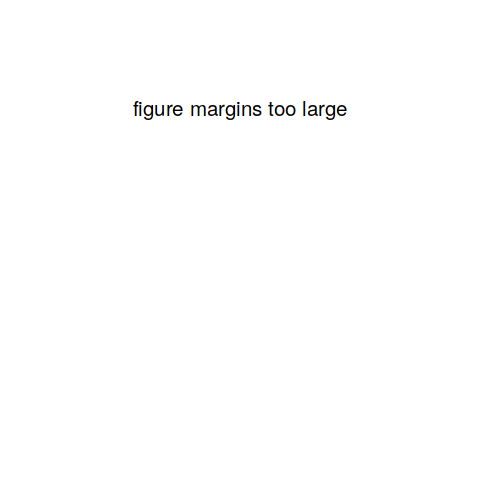

In [167]:
library(AUCell)
cells_rankings <- AUCell_buildRankings(ST_obj@assays$SCT@data)

In [168]:
cells_AUC <- AUCell_calcAUC(modules_list, cells_rankings, aucMaxRank=nrow(cells_rankings)*0.1)

Warning message in .AUCell_calcAUC(geneSets = geneSets, rankings = rankings, nCores = nCores, :
“The following gene sets will be excluded from the analysis(less than 20% of their genes are available):
c1_8, c1_134, c1_587, c1_10”
Genes in the gene sets NOT available in the dataset: 
	c1_3: 	68 (36% of 189)
	c1_7: 	42 (8% of 497)
	c1_14: 	23 (25% of 92)
	c1_53: 	6 (15% of 39)
	c1_105: 	20 (51% of 39)
	c1_111: 	17 (17% of 98)
	c1_112: 	33 (52% of 64)
	c1_159: 	12 (15% of 80)
	c1_380: 	3 (14% of 22)
	c1_429: 	3 (10% of 29)
	c1_557: 	11 (50% of 22)
	c1_564: 	11 (19% of 58)
	c1_609: 	10 (15% of 65)
	c1_122: 	4 (6% of 66)
	c1_567: 	24 (51% of 47)
	c1_585: 	20 (62% of 32)
	c1_121: 	7 (6% of 119)
	c1_123: 	9 (12% of 73)
	c1_364: 	6 (19% of 32)
	c1_574: 	5 (12% of 40)
	c1_578: 	6 (6% of 101)
	c1_581: 	4 (9% of 45)
	c1_769: 	3 (4% of 68)



In [169]:
modules_list$c1_53

[1] "EGR1"         "FOS"          "DUSP1"        "FOSB"         "NR4A1"       
 [6] "EGR3"         "EGR2"         "IER2"         "MIR23A"       "ATF3"        
[11] "JUN"          "KLF6"         "SOCS3"        "CSRNP1"       "GADD45B"     
[16] "HBEGF"        "IL6"          "BTG2"         "KLF4"         "DUSP5"       
[21] "JUNB"         "DUSP2"        "NR4A3"        "FOSL1"        "ARC"         
[26] "LOC102724428" "RASD1"        "NR4A1AS"      "PER1"         "IER3"        
[31] "MIR4530"      "BBC3"         "ZFP36"        "MIR27A"       "PPP1R15A"    
[36] "RHOB"         "SGK1"         "RN7SL265P"    "TSC22D3"

In [170]:
ST_obj$M53 <- as.numeric(getAUC(cells_AUC)['c1_53', ])
ST_obj$M769 <- as.numeric(getAUC(cells_AUC)['c1_769', ])
ST_obj$proliferation <- as.numeric(getAUC(cells_AUC)['proliferation', ])

In [171]:
proliferationGene

[1] "AURKA" "BUB1"  "CCNB1" "CCND1" "CCNE1" "DEK"   "E2F1"  "FEN1"  "FOXM1"
[10] "H2AFZ" "HMGB2" "MCM2"  "MCM3"  "MCM4"  "MCM5"  "MCM6"  "MKI67" "MYBL2"
[19] "PCNA"  "PLK1"  "TOP2A" "TYMS"  "ZWINT"

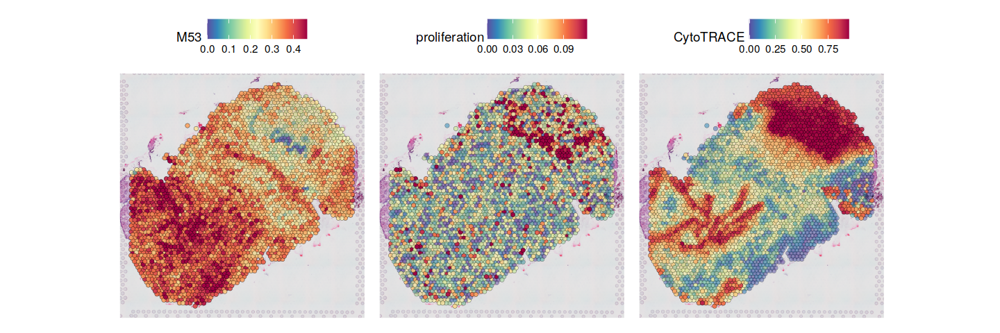

In [174]:
options(repr.plot.height = 4, repr.plot.width = 12)
p2 <- SpatialPlot(ST_obj, features = c('M53','proliferation','CytoTRACE'),alpha =  c(0.5, 1),interactive = F,max.cutoff = "q95",ncol = 3,combine = T)
p2

In [176]:
pdf(file = './output/bulk/section_5/3.ST_P8_M53plot.pdf',width = 12,height = 4)
print(p2)
dev.off()

png 
  2

In [30]:
cor.test(ST_obj$M53,ST_obj$CytoTRACE)


	Pearson's product-moment correlation

data:  ST_obj$M53 and ST_obj$CytoTRACE
t = -9.7158, df = 3178, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 -0.2034004 -0.1358859
sample estimates:
       cor 
-0.1698424 


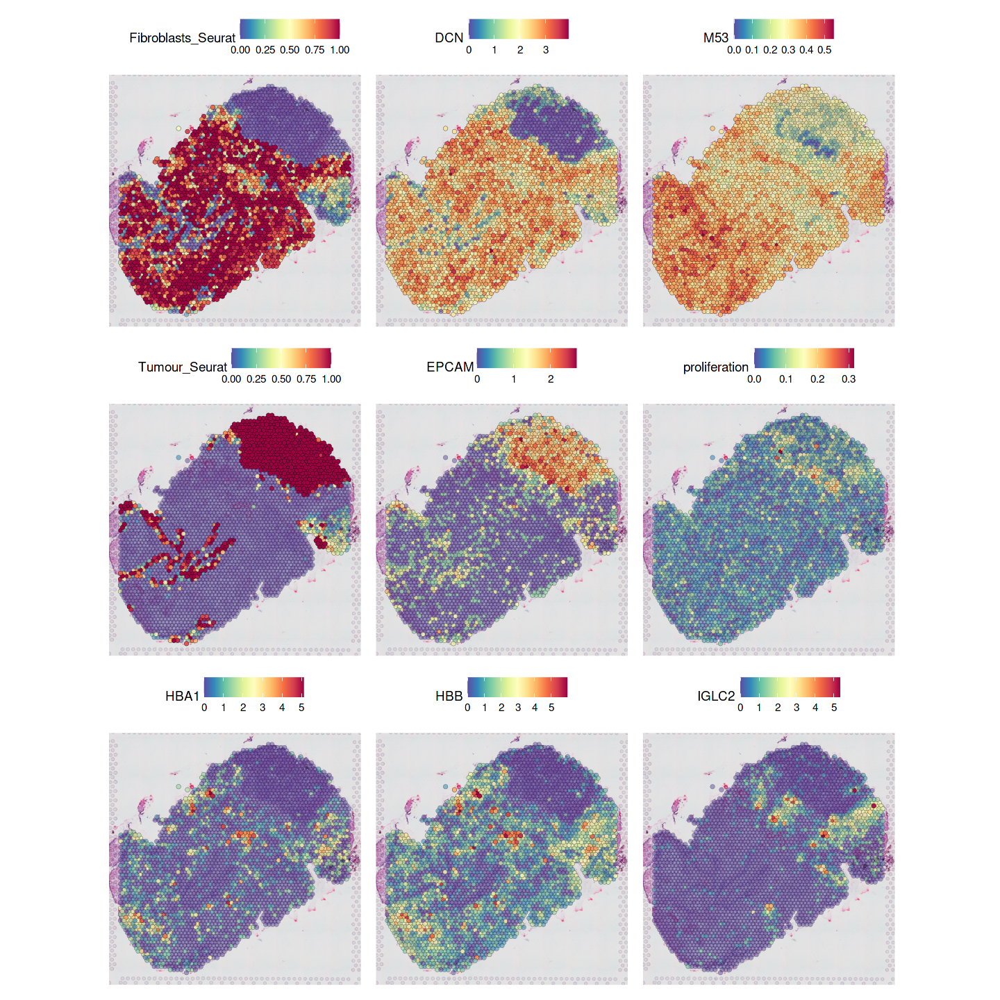

In [66]:
options(repr.plot.height = 12, repr.plot.width = 12)
p3 <- SpatialFeaturePlot(ST_obj, features = c('Fibroblasts_Seurat','DCN','M53','Tumour_Seurat','EPCAM','proliferation','HBA1','HBB','IGLC2'),alpha =  c(0.5, 1),ncol = 3,combine = T)
p3 

In [67]:
pdf(file = './output/bulk/section_5/3.ST_P8_immune_cell_selectgene_plot.pdf',width = 12,height = 12)
print(p3)
dev.off()

png 
  2

## P1

In [133]:
ST_obj <- FindClusters(ST_obj,resolution = 0.8, verbose = FALSE) 

In [134]:
table(ST_obj$seurat_clusters)


  0   1   2   3   4   5   6   7   8   9  10  11 
511 347 329 316 310 266 242 242 224 181 134  78 

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


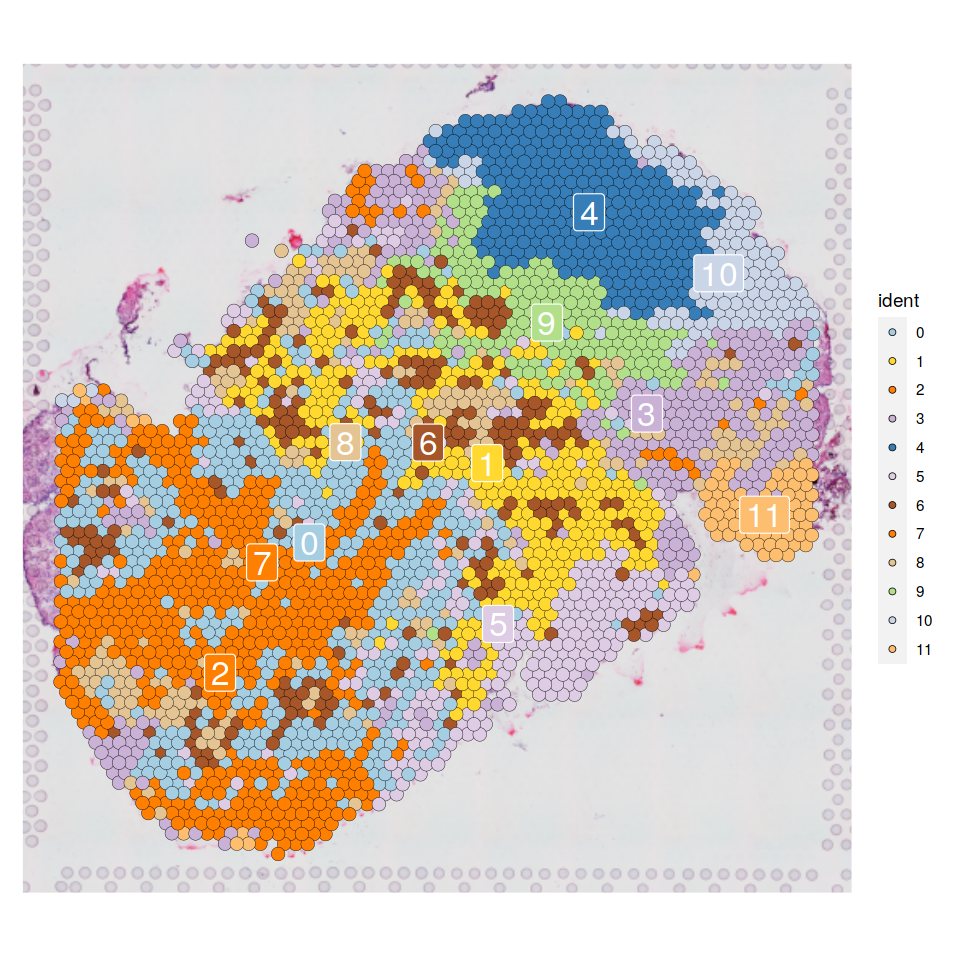

In [135]:
library(RColorBrewer)
qual_col_pals = brewer.pal.info[brewer.pal.info$category == 'qual',]
#处理后有73种差异还比较明显的颜色，基本够用
col_vector = unlist(mapply(brewer.pal, qual_col_pals$maxcolors, rownames(qual_col_pals)))
set.seed(seed = 12344)
cellType_col <- sample(col_vector, 12)
p1 <- SpatialDimPlot(ST_obj,label = T)+scale_fill_manual(values = cellType_col)
options(repr.plot.height = 8, repr.plot.width = 8)
p1

Warning message in FetchData.Seurat(object = object, vars = features, cells = cells):
“The following requested variables were not found:  CXCL13”


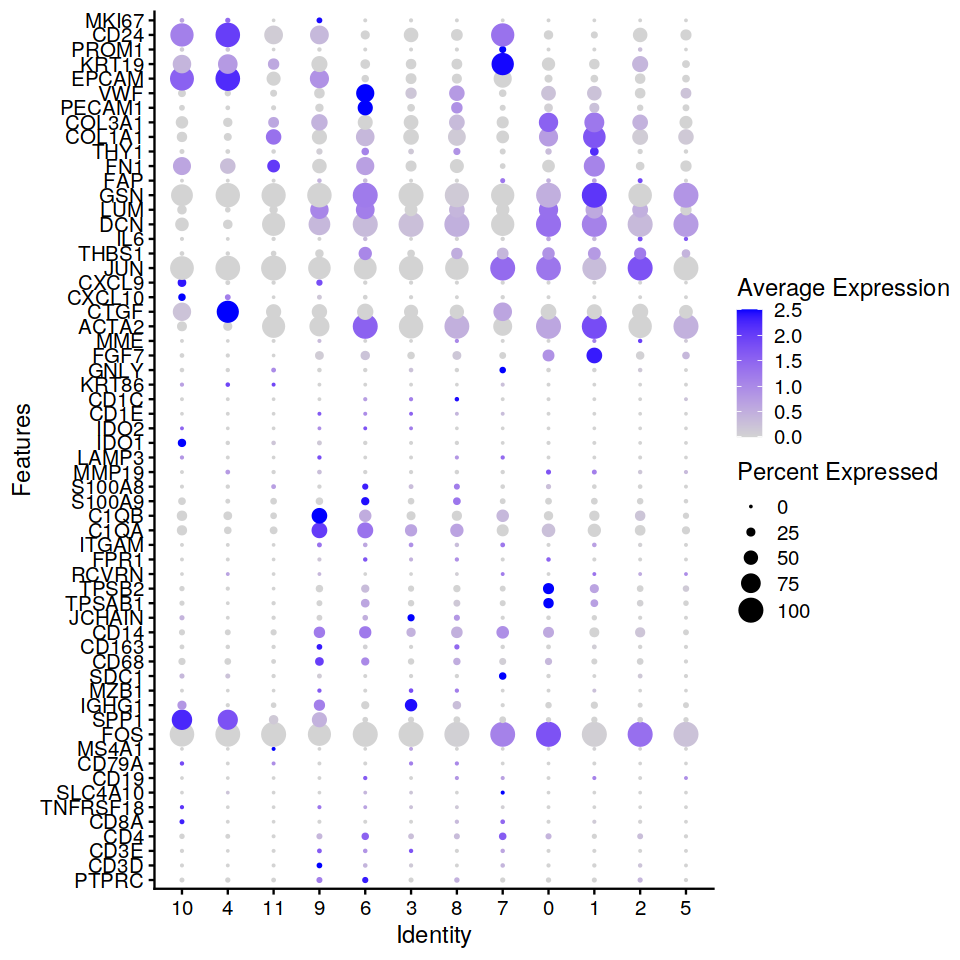

In [136]:
options(repr.plot.height = 8, repr.plot.width = 8)
DotPlot(ST_obj,group.by = 'seurat_clusters',assay = 'SCT', features = unique(genes_to_check),cluster.idents = T,col.min = 0) + coord_flip()

In [155]:
endo <- c(6)
B_Plasma <- c(3)
ciliated <- c(7)
Epithelial_1 <- c(4)
Epithelial_2 <- c(10)
Myofibro <- c(1,5)
TAM_tumor_mix <- c(9)
Fibroblasts <- c(0,2)
Erythroid <- c(8)
Unknow <- c(11)




current.cluster.ids <- c(endo,B_Plasma,ciliated,Epithelial_1,
                         Epithelial_2,Myofibro,
                         TAM_tumor_mix,Fibroblasts,Erythroid,Unknow
                         )

new.cluster.ids <- c(
                     rep("Endothelial cells",length(endo)),
                     rep("B/Plasma",length(B_Plasma)),
                     rep("Ciliated cells",length(ciliated)),
                     rep("Malignant epithelial cells",length(Epithelial_1)),
                     rep("Malignant epithelial cells",length(Epithelial_2)),
                     rep("Myofibro",length(Myofibro)),
                     rep("TAM_malignant_mix",length(TAM_tumor_mix)), 
                    rep("Fibroblasts",length(Fibroblasts)),
                     rep("Erythroid",length(Erythroid)),
    rep("Unknow",length(Unknow))
)
ST_obj@meta.data$cellType <- plyr::mapvalues(x = ST_obj@meta.data$seurat_clusters, from = current.cluster.ids, to = new.cluster.ids)


Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


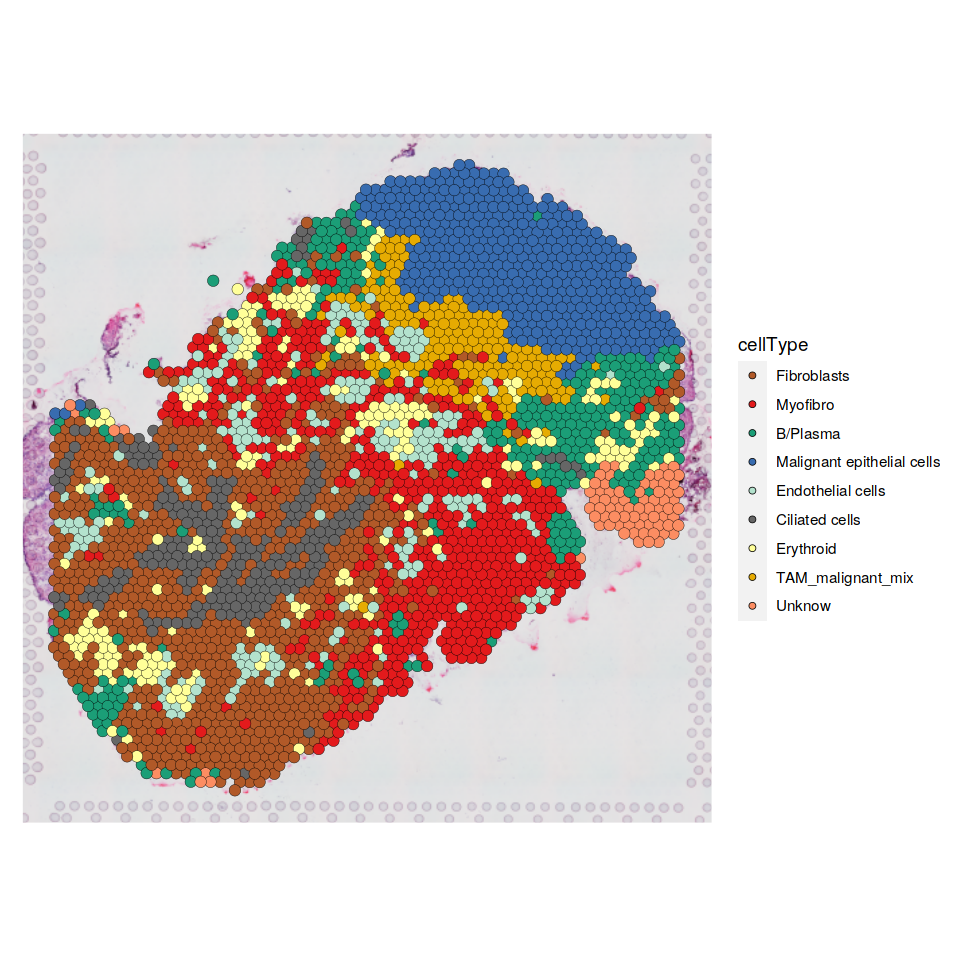

In [156]:
library(RColorBrewer)
qual_col_pals = brewer.pal.info[brewer.pal.info$category == 'qual',]
#处理后有73种差异还比较明显的颜色，基本够用
col_vector = unlist(mapply(brewer.pal, qual_col_pals$maxcolors, rownames(qual_col_pals)))
set.seed(seed = 1234)
cellType_col <- sample(col_vector, 10)
p1 <- SpatialDimPlot(ST_obj,group.by = 'cellType')+scale_fill_manual(values = cellType_col)
options(repr.plot.height = 8, repr.plot.width = 8)
p1

In [162]:
B_gene <- c('IGKC','IGHG1','HBA1','HBB')
Plasma_gene <- c('DERL3','MZB1','JCHAIN')
T_gene <-c('CD3D','CD3E','CD8A')
Epithelial_gene <-c('CAPSL','KRT19','CD24','KRT18','EPCAM')
myeloid_gene <-c('C1QB','C1QA','SPP1','CXCL10')
Endothelial_gene <-c('PECAM1','VWF')
Fibroblasts_gene <- c('MYH11','ACTA2','DCN')
cellMarker <- c(B_gene,myeloid_gene,Fibroblasts_gene,Endothelial_gene,Epithelial_gene)

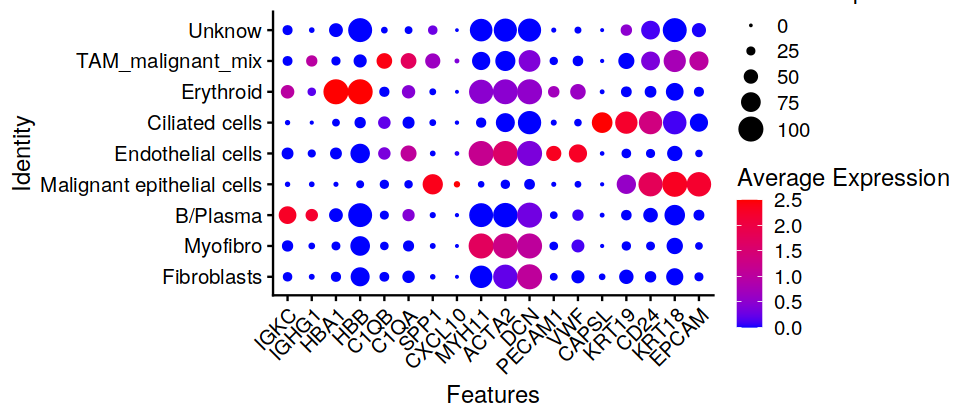

In [163]:
options(repr.plot.height = 3.5, repr.plot.width = 8)
dotp <- DotPlot(ST_obj,group.by = 'cellType',cols = c('blue','red'),col.min = 0, features = unique(cellMarker),cluster.idents = F) + theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1))
dotp

In [183]:
pdf(file = './output/bulk/section_5/3.ST_P8_dotplot.pdf',width = 8,height = 3.5)
print(dotp)
dev.off()

png 
  2

In [165]:
library(ggpubr)

`geom_smooth()` using formula = 'y ~ x'


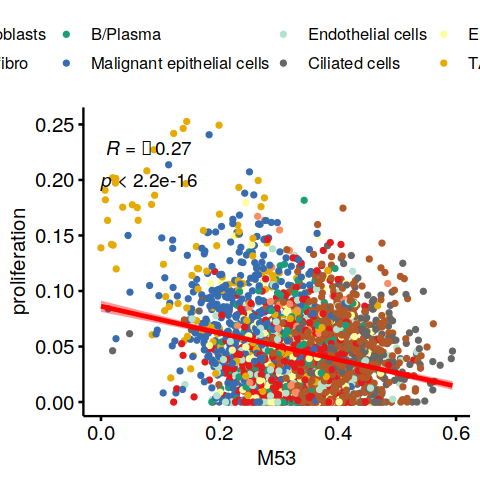

In [181]:
options(repr.plot.height = 4, repr.plot.width = 4)
p5 <- ggscatter(ST_obj@meta.data,x = 'M53',y = 'proliferation',color = 'cellType',size = 1, add = "reg.line", conf.int = TRUE,add.params = list(color = "red"),cor.coeff.args = list(method = "pearson", label.sep = "\n",color='black'),cor.coef = TRUE)+scale_color_manual(values = cellType_col)
p5

In [178]:
proliferationGene

[1] "AURKA" "BUB1"  "CCNB1" "CCND1" "CCNE1" "DEK"   "E2F1"  "FEN1"  "FOXM1"
[10] "H2AFZ" "HMGB2" "MCM2"  "MCM3"  "MCM4"  "MCM5"  "MCM6"  "MKI67" "MYBL2"
[19] "PCNA"  "PLK1"  "TOP2A" "TYMS"  "ZWINT"

`geom_smooth()` using formula = 'y ~ x'


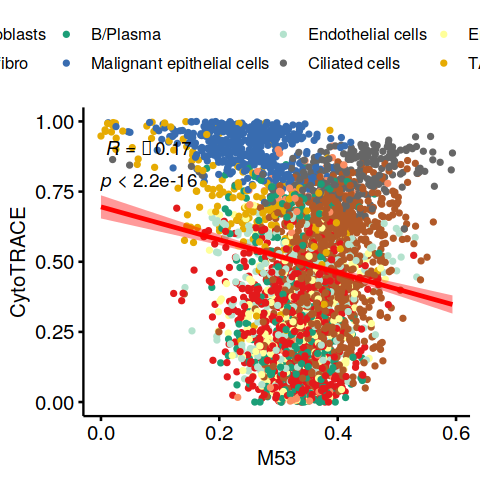

In [179]:
options(repr.plot.height = 4, repr.plot.width = 4)
p5 <- ggscatter(ST_obj@meta.data,x = 'M53',y = 'CytoTRACE',color = 'cellType',size = 1, add = "reg.line", conf.int = TRUE,add.params = list(color = "red"),cor.coeff.args = list(method = "pearson", label.sep = "\n",color='black'),cor.coef = TRUE)+scale_color_manual(values = cellType_col)
p5

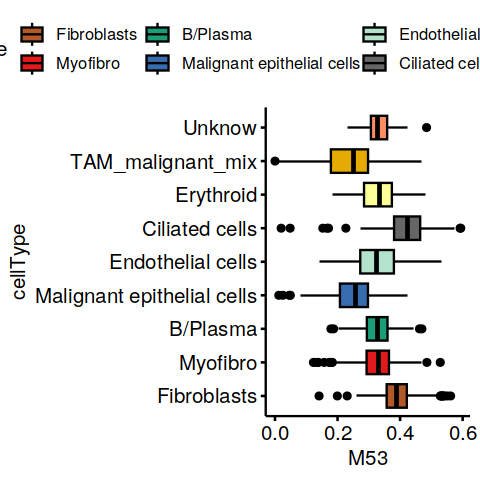

In [180]:
options(repr.plot.height = 4, repr.plot.width = 4)
p2 <- ggboxplot(data = ST_obj@meta.data,x = 'cellType',y = 'M53',fill = 'cellType')+scale_fill_manual(values = cellType_col)+ coord_flip()
p2

In [182]:
pdf(file = './output/bulk/section_5/3.ST_P8_plot.pdf',width = 4,height = 4)
print(p1)
print(p5)
print(p2)
dev.off()

`geom_smooth()` using formula = 'y ~ x'


png 
  2

In [44]:
MarkerGene <- FindAllMarkers(ST_obj,only.pos = T,logfc.threshold = 0.5)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11



In [37]:
subset(MarkerGene,gene=='CTGF')

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
CTGF,6.948157e-40,0.6073315,0.865,0.557,1.338146e-35,4,CTGF


In [96]:
subset(MarkerGene,cluster=='8')

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
HBA1,1.506472e-193,3.8602788,1.000,0.271,2.901315e-189,8,HBA1
HBA2,2.221940e-143,4.2146534,1.000,0.584,4.279233e-139,8,HBA2
HBB,3.373005e-138,4.2226478,1.000,0.631,6.496070e-134,8,HBB
SLC25A37,5.100654e-22,0.5501827,0.446,0.197,9.823349e-18,8,SLC25A37
IGKC1,1.011051e-08,1.2719509,0.460,0.294,1.947182e-04,8,IGKC
IGHM1,1.682833e-07,0.8443004,0.286,0.151,3.240969e-03,8,IGHM


In [ ]:
ST_obj <- readRDS(file = paste0('./data/GSE211956_RAW/ST_Anchoring/Anchoring_GSM6506110_ST.RDS'))

In [ ]:
colnames(ST_obj@meta.data)[8:15] <- c('B_CARD','Plasma_CARD','T_CARD','Myeloid_CARD','NK_CARD','Fibroblasts_CARD','Endothelial_CARD','Tumour_CARD')

In [ ]:
colnames(ST_obj@meta.data)[16:23] <- c('B_Seurat','Plasma_Seurat','Fibroblasts_Seurat','Endothelial_Seurat','T_Seurat','NK_Seurat','Myeloid_Seurat','Tumour_Seurat')

Quantiles for the number of genes detected by cell: 
(Non-detected genes are shuffled at the end of the ranking. Keep it in mind when choosing the threshold for calculating the AUC).



    min      1%      5%     10%     50%    100% 
1110.00 1175.39 1245.95 1341.70 2409.00 4240.00 


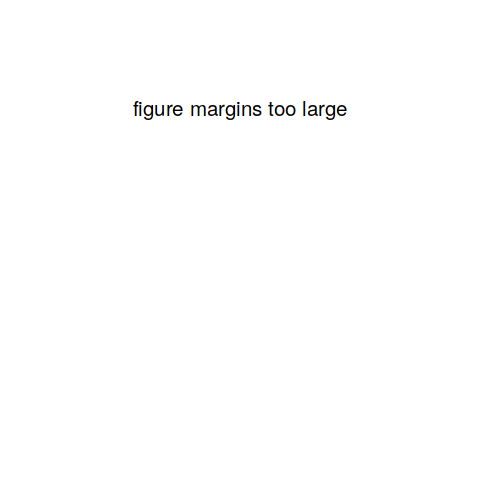

In [187]:
library(AUCell)
cells_rankings <- AUCell_buildRankings(ST_obj@assays$SCT@data)

In [188]:
modules_list$proliferation

[1] "AURKA" "BUB1"  "CCNB1" "CCND1" "CCNE1" "DEK"   "E2F1"  "FEN1"  "FOXM1"
[10] "H2AFZ" "HMGB2" "MCM2"  "MCM3"  "MCM4"  "MCM5"  "MCM6"  "MKI67" "MYBL2"
[19] "PCNA"  "PLK1"  "TOP2A" "TYMS"  "ZWINT"

In [189]:
cells_AUC <- AUCell_calcAUC(modules_list, cells_rankings, aucMaxRank=nrow(cells_rankings)*0.1)

Warning message in .AUCell_calcAUC(geneSets = geneSets, rankings = rankings, nCores = nCores, :
“The following gene sets will be excluded from the analysis(less than 20% of their genes are available):
c1_134, c1_587, c1_10”
Genes in the gene sets NOT available in the dataset: 
	c1_3: 	67 (35% of 189)
	c1_7: 	48 (10% of 497)
	c1_14: 	22 (24% of 92)
	c1_53: 	6 (15% of 39)
	c1_105: 	22 (56% of 39)
	c1_111: 	17 (17% of 98)
	c1_112: 	32 (50% of 64)
	c1_159: 	11 (14% of 80)
	c1_380: 	3 (14% of 22)
	c1_429: 	3 (10% of 29)
	c1_557: 	12 (55% of 22)
	c1_564: 	13 (22% of 58)
	c1_609: 	10 (15% of 65)
	c1_8: 	98 (75% of 131)
	c1_122: 	7 (11% of 66)
	c1_567: 	23 (49% of 47)
	c1_585: 	19 (59% of 32)
	c1_121: 	7 (6% of 119)
	c1_123: 	5 (7% of 73)
	c1_364: 	6 (19% of 32)
	c1_574: 	5 (12% of 40)
	c1_578: 	6 (6% of 101)
	c1_581: 	7 (16% of 45)
	c1_769: 	2 (3% of 68)



In [190]:
ST_obj$M53 <- as.numeric(getAUC(cells_AUC)['c1_53', ])
ST_obj$M769 <- as.numeric(getAUC(cells_AUC)['c1_769', ])
ST_obj$proliferation <- as.numeric(getAUC(cells_AUC)['proliferation', ])

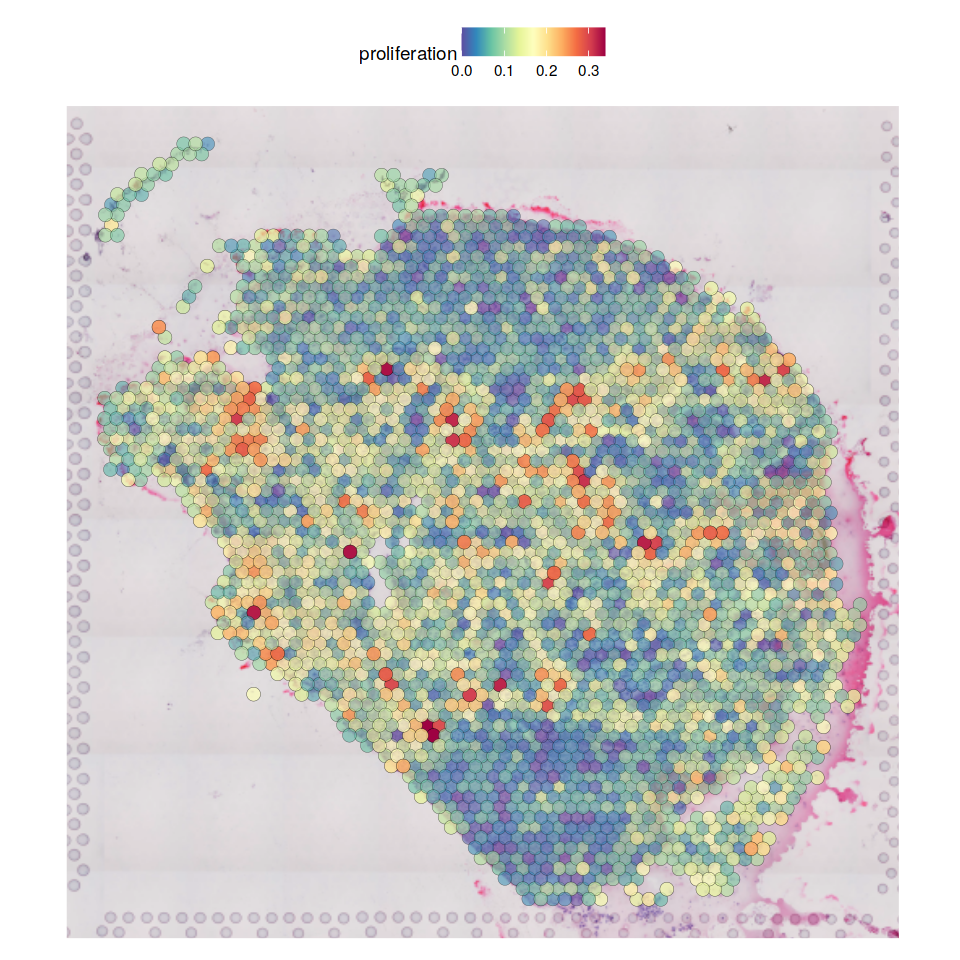

In [54]:
options(repr.plot.height = 8, repr.plot.width = 8)
SpatialFeaturePlot(ST_obj, features = c('proliferation'),alpha =  c(0.5, 1))


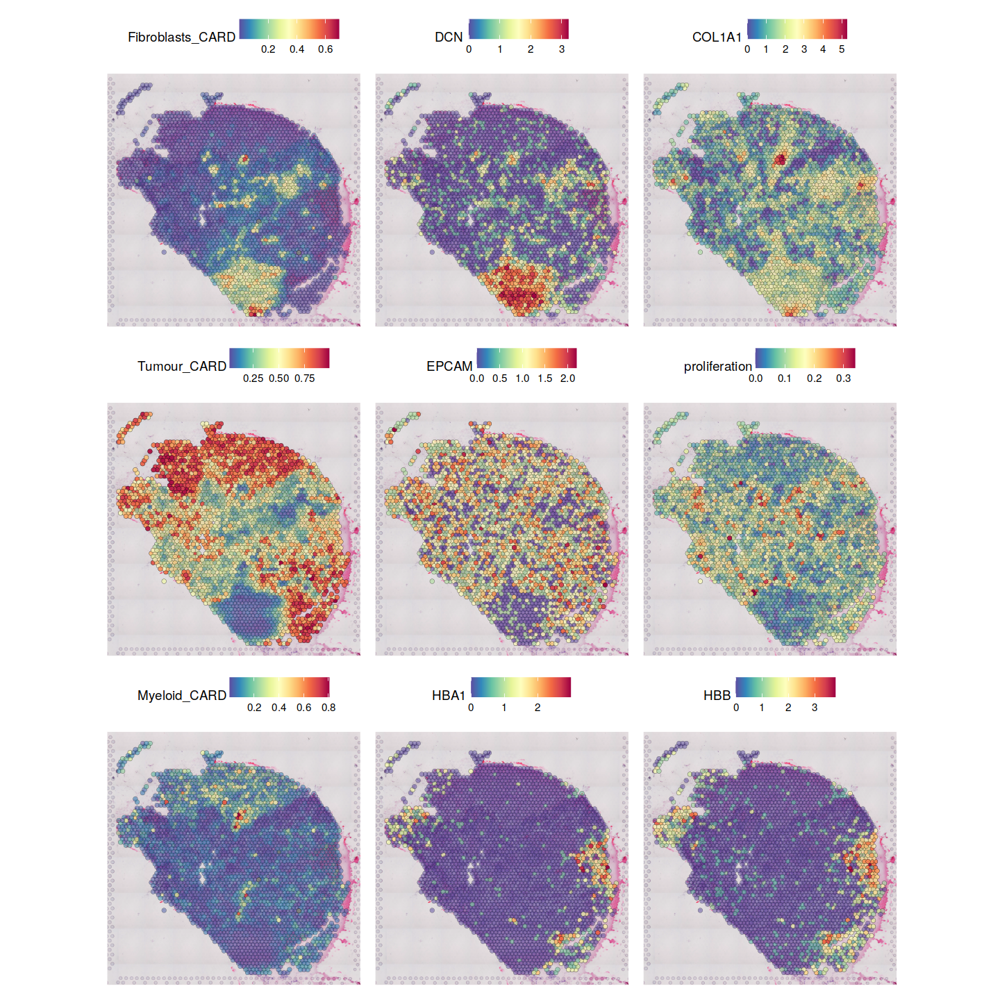

In [55]:
options(repr.plot.height = 12, repr.plot.width = 12)
p3 <- SpatialFeaturePlot(ST_obj, features = c('Fibroblasts_CARD','DCN','COL1A1','Tumour_CARD','EPCAM','proliferation','Myeloid_CARD','HBA1','HBB'),alpha =  c(0.5, 1),ncol = 3,combine = T)
p3 

In [30]:
ImageDimPlot(ST_obj, molecules = "COL1A1", nmols = 10000, alpha = 0.3, mols.cols = "red")

ERROR: Error in library(imaging): there is no package called ‘imaging’


In [28]:
ST_obj <- AddModuleScore(object = ST_obj,assay = 'SCT',features = modules_list['c1_53'])

Warning message:
“The following features are not present in the object: MIR23A, LOC102724428, NR4A1AS, MIR4530, MIR27A, RN7SL265P, not searching for symbol synonyms”


In [83]:
head(ST_obj)

,orig.ident,nCount_Spatial,nFeature_Spatial,nCount_SCT,nFeature_SCT,SCT_snn_res.1,seurat_clusters,B_CARD,Plasma_CARD,T_CARD,⋯,pred.endo_bin,pred.T_bin,pred.NK_bin,pred.myeloid_bin,pred.Epi_bin,M53,M769,proliferation,CytoTRACE,Cluster1
,<fct>,<dbl>,<int>,<dbl>,<int>,<fct>,<fct>,<dbl>,<dbl>,<dbl>,⋯,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
AAACAAGTATCTCCCA-1,OV,7302,1943,6597,1942,1,1,0.12783684,0.111290173,0.063096435,⋯,0,0,0,0,0,0.17221354,0.04077150,0.04397938,0.26342282,0.006432867
AAACATTTCCCGGATT-1,OV,1470,854,4769,1163,3,3,0.09362657,0.007232636,0.024921610,⋯,0,0,0,0,0,0.09364902,0.06093425,0.06972749,0.34731544,0.013287126
AAACCGGGTAGGTACC-1,OV,4073,1834,5463,1834,2,2,0.01476077,0.003458388,0.002551312,⋯,0,0,0,0,0,0.11518130,0.03982900,0.01782561,0.26174497,-0.091353297
AAACCGTTCGTCCAGG-1,OV,45713,9213,7203,3735,6,6,0.01640859,0.042839037,0.046445400,⋯,0,0,0,0,1,0.00000000,0.04136056,0.12010213,0.98657718,0.029156721
AAACCTCATGAAGTTG-1,OV,1884,925,5116,1117,1,1,0.04804032,0.001908042,0.004331288,⋯,0,0,0,0,0,0.18452833,0.04714179,0.08352026,0.17058166,0.027247902
AAACGAGACGGTTGAT-1,OV,2997,1577,5817,1613,3,3,0.19397687,0.014489025,0.019862486,⋯,0,0,0,0,0,0.10094557,0.03674905,0.06139932,0.30592841,-0.009463507
AAACTGCTGGCTCCAA-1,OV,5953,2692,6051,2690,0,0,0.05585922,0.003940454,0.012509513,⋯,0,0,0,0,0,0.17694885,0.05012076,0.05192574,0.77516779,0.036556675
AAAGGCTCTCGCGCCG-1,OV,25368,6043,6463,2513,6,6,0.18001908,0.092812122,0.179573464,⋯,0,0,0,0,0,0.03484476,0.03339140,0.07793633,0.92393736,0.060152749
AAAGGGATGTAGCAAG-1,OV,1525,793,5008,1128,0,0,0.18569549,0.063029247,0.025781523,⋯,0,0,0,0,0,0.19373092,0.02919223,0.03815683,0.09116331,-0.031128818


In [ ]:
setwd('/home/data/t060324/jobs/aimin/')
library(CytoTRACE)
ST_obj <- readRDS(file = paste0('./data/GSE211956_RAW/GSM6506110_ST.RDS'))
expr <- as.matrix(ST_obj@assays$Spatial@counts)
results <- CytoTRACE(mat=expr,enableFast=F)
saveRDS(results,file='./output/5.ST_CytoTRACE/CytoTRACE_GSM6506110_results.RDS')
gc()

In [191]:
results <- readRDS(file='./output/5.ST_CytoTRACE/CytoTRACE_GSM6506110_results.RDS')
ST_obj$CytoTRACE <- results$CytoTRACE

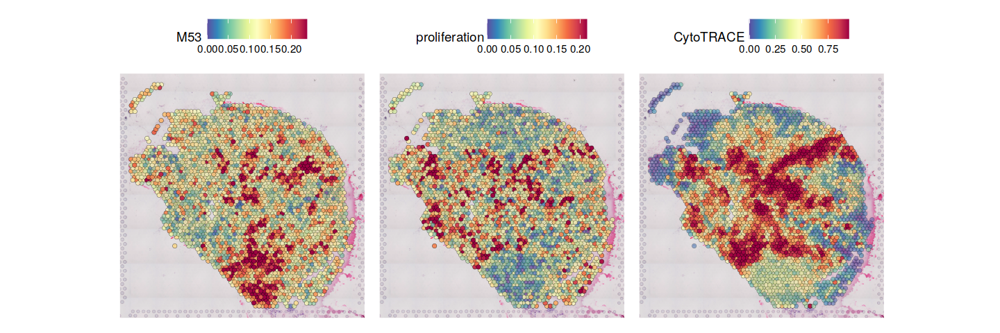

In [192]:
options(repr.plot.height = 4, repr.plot.width = 12)
p2 <- SpatialPlot(ST_obj, features = c('M53','proliferation','CytoTRACE'),alpha =  c(0.5, 1),interactive = F,max.cutoff = "q95",ncol = 3,combine = T)
p2

In [58]:
pdf(file = './output/bulk/section_5/3.ST_P1_M53plot.pdf',width = 12,height = 4)
print(p2)
dev.off()

png 
  2

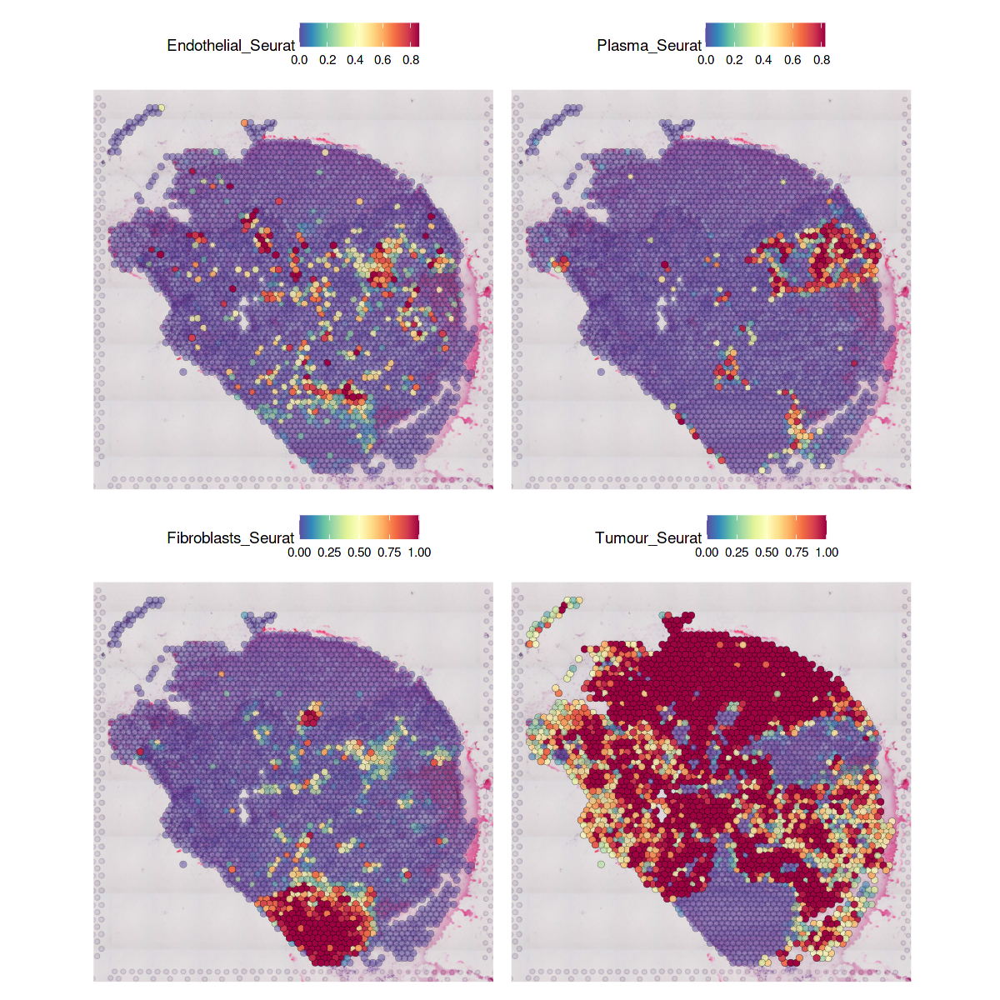

In [68]:
options(repr.plot.height = 10, repr.plot.width = 10)
SpatialFeaturePlot(ST_obj, features = c('Endothelial_Seurat','Plasma_Seurat','Fibroblasts_Seurat','Tumour_Seurat'),alpha =  c(0.5, 1),min.cutoff =0,max.cutoff = 'q95' ,ncol = 2,combine = T)

In [49]:
which(is.na(ST_obj@meta.data$Myeloid_CARD))

[1]  341 2492 2521

In [62]:
ST_obj@meta.data[which(is.na(ST_obj@meta.data$Plasma_CARD)),c('B_CARD','Plasma_CARD','T_CARD','Myeloid_CARD','NK_CARD','Fibroblasts_CARD','Endothelial_CARD','Tumour_CARD')] <- 0

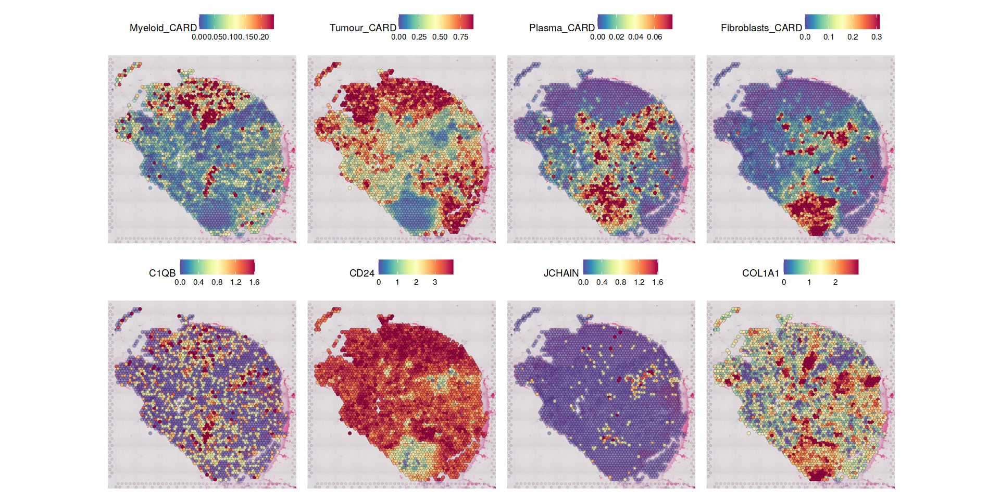

In [117]:
options(repr.plot.height = 8, repr.plot.width = 16)
p3 <- SpatialFeaturePlot(ST_obj, features = c('Myeloid_CARD','Tumour_CARD','Plasma_CARD','Fibroblasts_CARD','C1QB','CD24','JCHAIN','COL1A1'),alpha =  c(0.5, 1),max.cutoff = 'q95',ncol = 4,combine = T)
p3 

In [136]:
pdf(file = './output/bulk/section_5/3.ST_P1_immune_cell_selectgene_plot.pdf',width = 16,height = 8)
print(p3)
dev.off()

png 
  2

In [39]:
cor.test(ST_obj$M53,ST_obj$proliferation)


	Pearson's product-moment correlation

data:  ST_obj$M53 and ST_obj$proliferation
t = -15.973, df = 2938, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 -0.3155942 -0.2490644
sample estimates:
       cor 
-0.2826692 


`geom_smooth()` using formula = 'y ~ x'


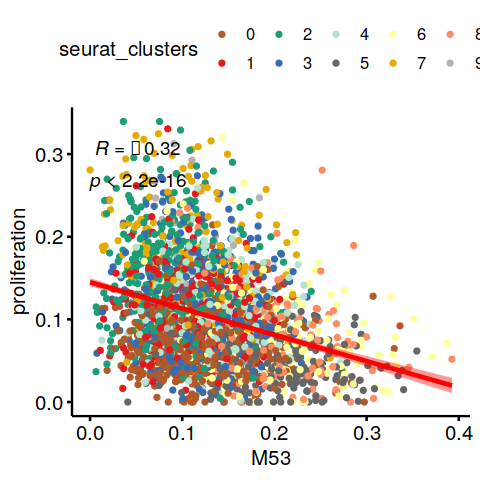

In [193]:
library(ggpubr)
options(repr.plot.height = 4, repr.plot.width = 4)
p5 <- ggscatter(ST_obj@meta.data,x = 'M53',y = 'proliferation',color = 'seurat_clusters',size = 1, add = "reg.line", conf.int = TRUE,add.params = list(color = "red"),cor.coeff.args = list(method = "pearson", label.sep = "\n",color='black'),cor.coef = TRUE)+scale_color_manual(values = cellType_col)
p5

In [91]:
genes_to_check = c('PTPRC', 'CD3D', 'CD3E', 'CD4','CD8A','TNFRSF18','SLC4A10',
                   'CD19', 'CD79A', 'MS4A1' ,'FOS','SPP1',
                   'IGHG1', 'MZB1', 'SDC1',
                   'CD68', 'CD163', 'CD14', 'JCHAIN',' CXCL13',
                   'TPSAB1' , 'TPSB2',  # mast cells,
                   'RCVRN','FPR1' , 'ITGAM' ,
                   'C1QA',  'C1QB',  # mac
                   'S100A9', 'S100A8', 'MMP19',# monocyte
                   'LAMP3', 'IDO1','IDO2',## DC3 
                   'CD1E','CD1C', # DC2
                   'KRT86','GNLY', # NK 
                   'FGF7','MME', 'ACTA2','CTGF','CXCL10','CXCL9','JUN','THBS1','IL6', ## fibo 
                   'DCN', 'LUM',  'GSN' , ## mouse PDAC fibo 
                   'FAP','FN1','THY1','COL1A1','COL3A1', 
                   'PECAM1', 'VWF',  ## endo 
                   'EPCAM' , 'KRT19', 'PROM1', 'CD24','MKI67' )
                   
                   

In [194]:
ST_obj <- FindClusters(ST_obj,resolution = 0.8, verbose = FALSE) 

Warning message:
“Could not find SLC4A10 in the default search locations, found in Spatial assay instead”
Warning message:
“Could not find CD1E in the default search locations, found in Spatial assay instead”
Warning message in FetchData.Seurat(object = object, vars = features, cells = cells):
“The following requested variables were not found:  CXCL13”


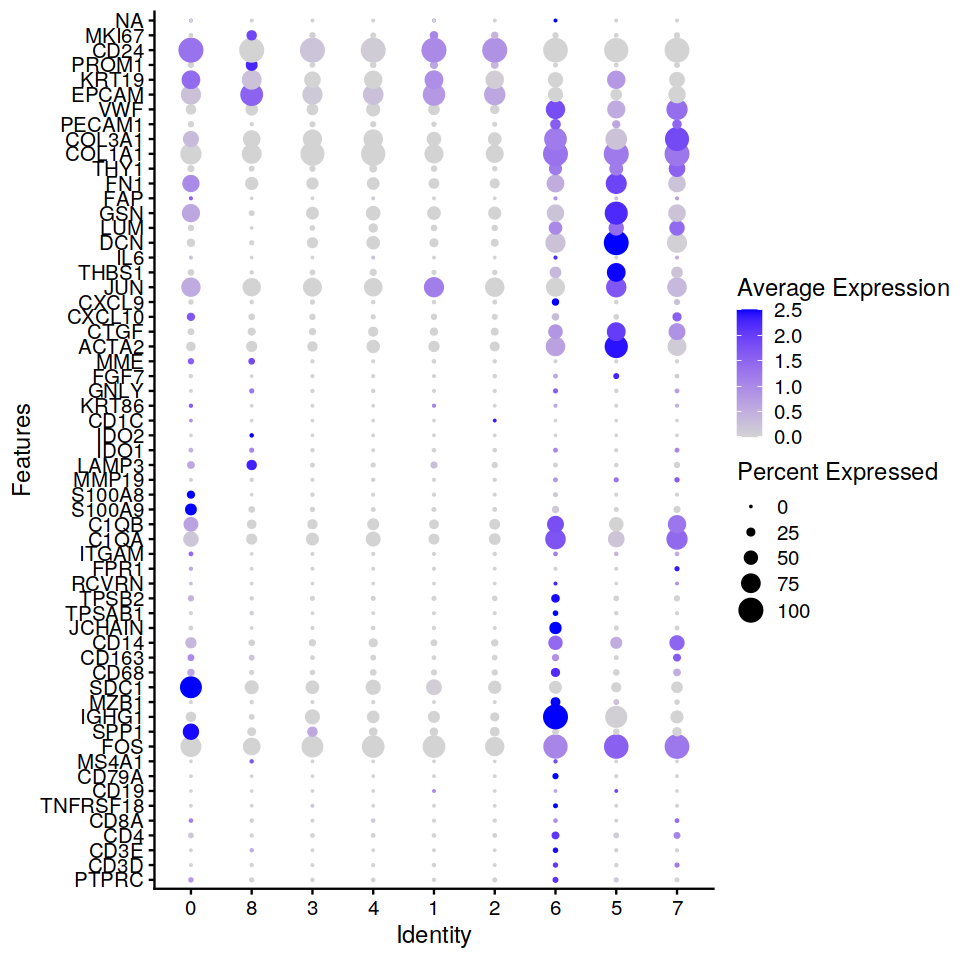

In [195]:
options(repr.plot.height = 8, repr.plot.width = 8)
DotPlot(ST_obj,group.by = 'seurat_clusters', features = unique(genes_to_check),cluster.idents = T,col.min = 0) + coord_flip()

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


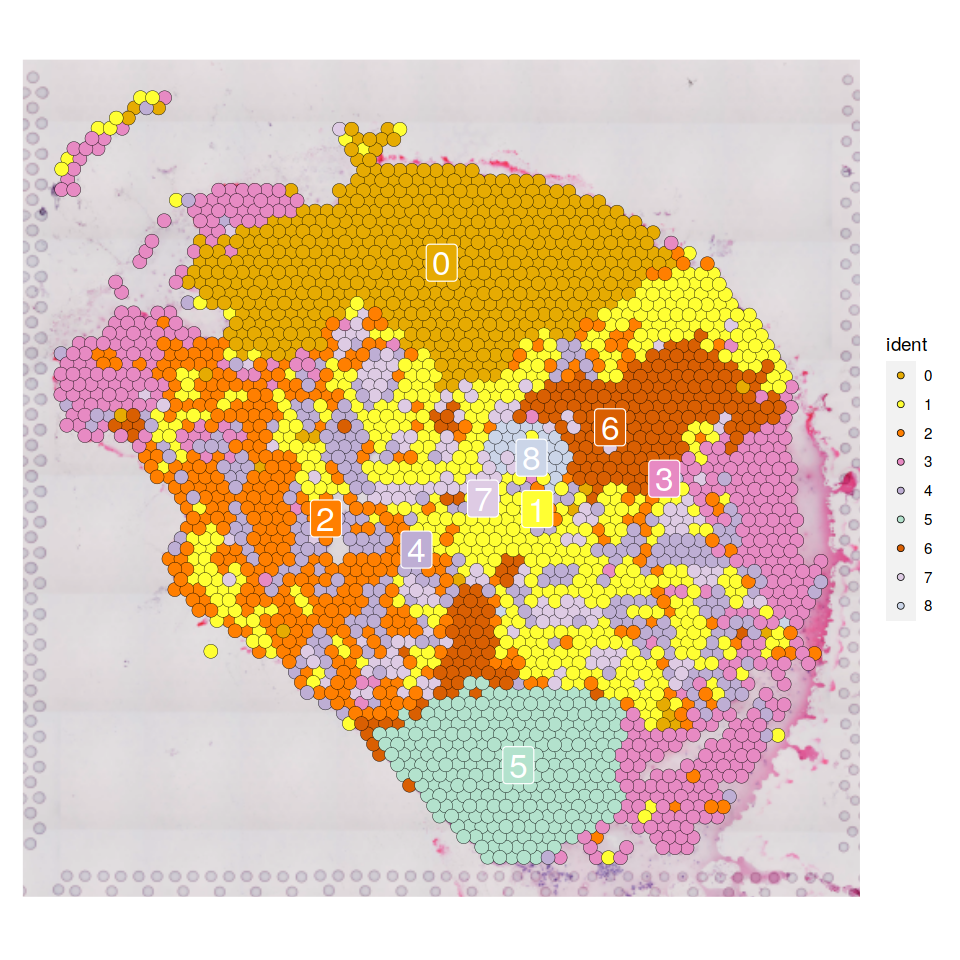

In [196]:
library(RColorBrewer)
qual_col_pals = brewer.pal.info[brewer.pal.info$category == 'qual',]
#处理后有73种差异还比较明显的颜色，基本够用
col_vector = unlist(mapply(brewer.pal, qual_col_pals$maxcolors, rownames(qual_col_pals)))
set.seed(seed = 12345)
cellType_col <- sample(col_vector, 10)
p1 <- SpatialDimPlot(ST_obj,label = T)+scale_fill_manual(values = cellType_col)
options(repr.plot.height = 8, repr.plot.width = 8)
p1

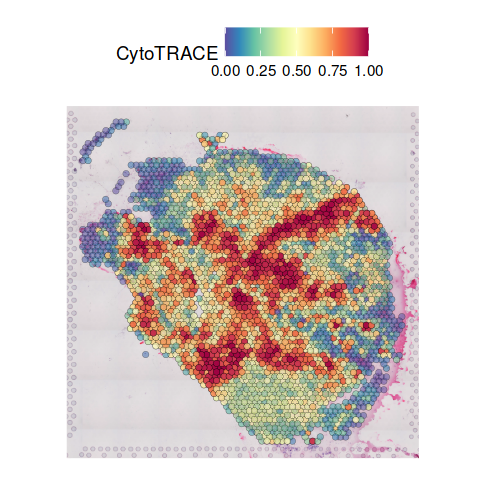

In [197]:
options(repr.plot.height = 4, repr.plot.width = 4)
SpatialFeaturePlot(ST_obj, features = c('CytoTRACE'),alpha =  c(0.5, 1))


In [198]:
TAM_tumor_mix <- c(0)
Fibroblasts <- c(5)
Immune_Fibroblasts_mix <- c(6)
Erythroid <- c(3,7)
Tumor_CAF_mix_1 <- c(1,2,4,8)



current.cluster.ids <- c(TAM_tumor_mix,Fibroblasts,Immune_Fibroblasts_mix,
                         Erythroid,Tumor_CAF_mix_1
                         )

new.cluster.ids <- c(
                     rep("TAM_Epithelial_mix",length(TAM_tumor_mix)),
                     rep("Fibroblasts",length(Fibroblasts)),
                     rep("Immune_Endothelial_mix",length(Immune_Fibroblasts_mix)),
                     rep("Erythroid",length(Erythroid)),
                     rep("Malignant epithelial cells",length(Tumor_CAF_mix_1))
)
ST_obj@meta.data$cellType <- plyr::mapvalues(x = ST_obj@meta.data$seurat_clusters, from = current.cluster.ids, to = new.cluster.ids)


In [199]:
ST_obj@meta.data$cellType <- as.character(ST_obj@meta.data$cellType)

In [200]:
B_gene <- c('IGKC','IGHG1','HBA1','HBB')
Plasma_gene <- c('DERL3','MZB1','JCHAIN')
T_gene <-c('CD3D','CD3E','CD8A')
Epithelial_gene <-c('KRT19','KRT18','CD24','EPCAM')
myeloid_gene <-c('C1QB','S100A9','SPP1','CXCL10')
Endothelial_gene <-c('PECAM1','VWF')
Fibroblasts_gene <- c('MYH11','ACTA2','DCN')
cellMarker <- c(B_gene,myeloid_gene,Fibroblasts_gene,Endothelial_gene,Epithelial_gene)

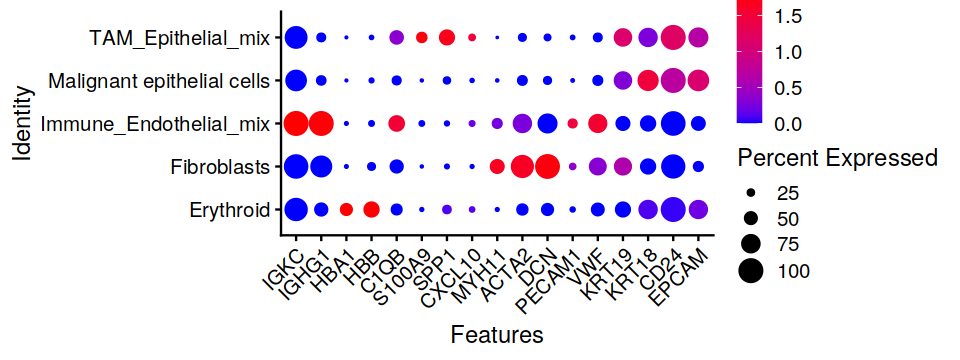

In [201]:
options(repr.plot.height = 3, repr.plot.width = 8)
dotp <- DotPlot(ST_obj,group.by = 'cellType',cols = c('blue','red'),col.min = 0, features = unique(c(cellMarker)),cluster.idents = F) + theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1))
dotp

In [202]:
pdf(file = './output/bulk/section_5/3.ST_P1_dotplot.pdf',width = 8,height = 3)
print(dotp)
dev.off()

png 
  2

In [203]:
ST_obj@meta.data$cellType <- as.factor(ST_obj@meta.data$cellType)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


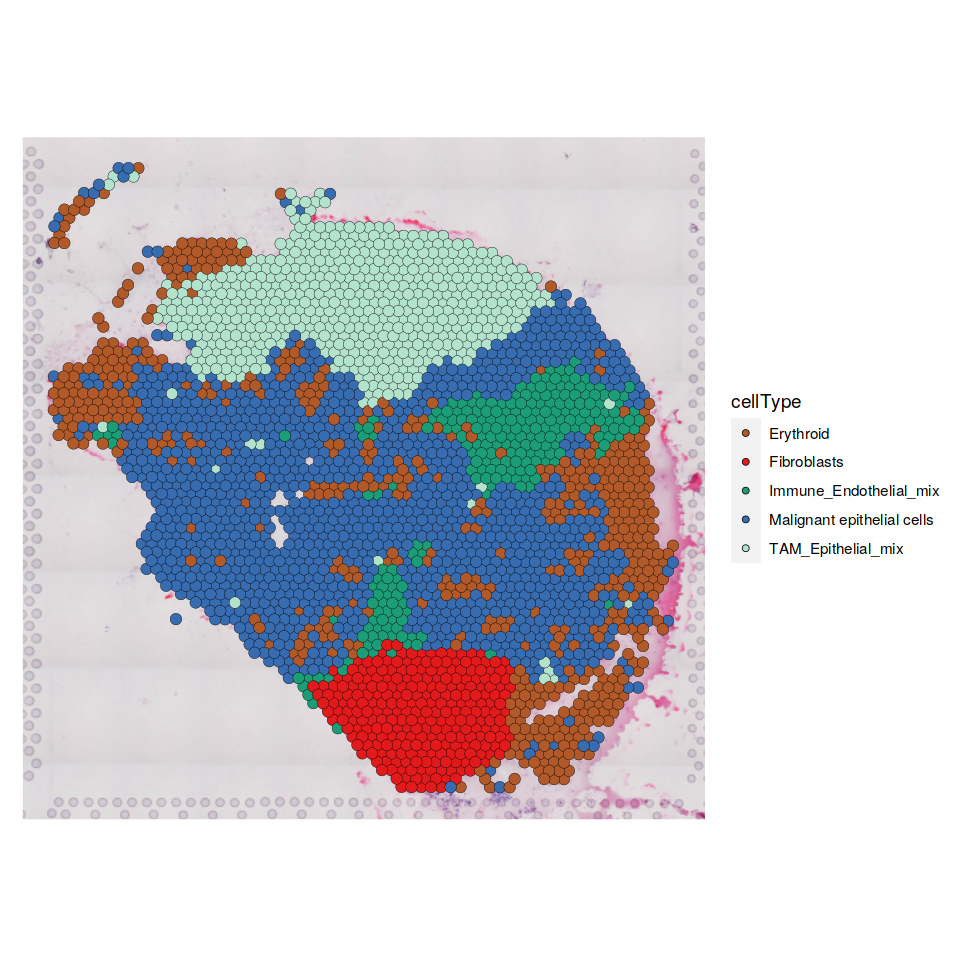

In [204]:
library(RColorBrewer)
qual_col_pals = brewer.pal.info[brewer.pal.info$category == 'qual',]
#处理后有73种差异还比较明显的颜色，基本够用
col_vector = unlist(mapply(brewer.pal, qual_col_pals$maxcolors, rownames(qual_col_pals)))
set.seed(seed = 1234)
cellType_col <- sample(col_vector, 7)
p1 <- SpatialDimPlot(ST_obj,group.by = 'cellType')+scale_fill_manual(values = cellType_col)
options(repr.plot.height = 8, repr.plot.width = 8)
p1

In [205]:
library(ggpubr)

`geom_smooth()` using formula = 'y ~ x'


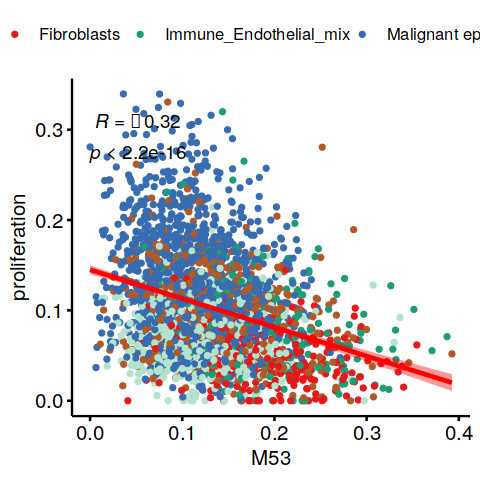

In [206]:
options(repr.plot.height = 4, repr.plot.width = 4)
p5 <- ggscatter(ST_obj@meta.data,x = 'M53',y = 'proliferation',color = 'cellType',size = 1, add = "reg.line", conf.int = TRUE,add.params = list(color = "red"),cor.coeff.args = list(method = "pearson", label.sep = "\n",color='black'),cor.coef = TRUE)+scale_color_manual(values = cellType_col)
p5

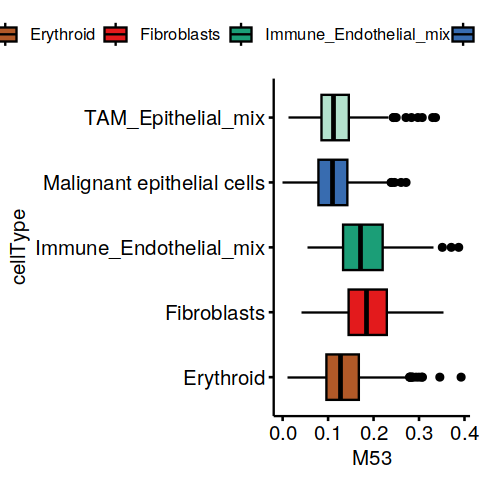

In [207]:
options(repr.plot.height = 4, repr.plot.width = 4)
p2 <- ggboxplot(data = ST_obj@meta.data,x = 'cellType',y = 'M53',fill = 'cellType')+scale_fill_manual(values = cellType_col)+ coord_flip()
p2

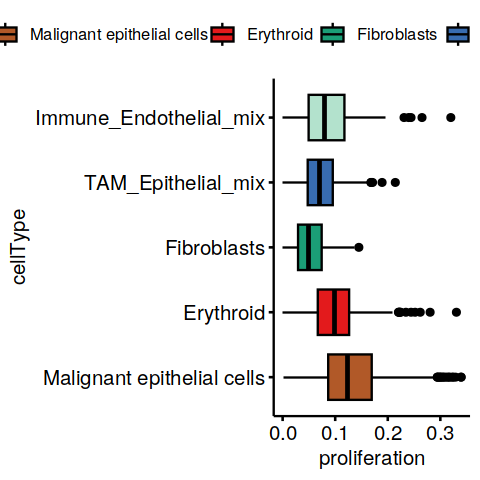

In [121]:
options(repr.plot.height = 4, repr.plot.width = 4)
p2 <- ggboxplot(data = ST_obj@meta.data,x = 'cellType',y = 'proliferation',fill = 'cellType')+scale_fill_manual(values = cellType_col)+ coord_flip()
p2

In [208]:
pdf(file = './output/bulk/section_5/3.ST_P1_plot.pdf',width = 4,height = 4)
print(p1)
print(p5)
print(p2)
dev.off()

`geom_smooth()` using formula = 'y ~ x'


png 
  2

In [81]:
MarkerGene <- FindAllMarkers(ST_obj,only.pos = T,logfc.threshold = 0.5)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

